In [ ]:
## Notebook env: cell2loc_env (cell2loc_env kernel)
## this notebook performs cell2location to *spatially* deconvolute cells using a reference annotated scRNAseq dataset

In [1]:
import sys
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import os

data_type = 'float32'

import cell2location

import matplotlib as mpl
from matplotlib import rcParams
import matplotlib.pyplot as plt
import seaborn as sns

# silence scanpy that prints a lot of warnings
import warnings
warnings.filterwarnings('ignore')

Global seed set to 0


In [2]:
results_folder = '/home/ssobti/projects/farnaz_spatial/output_data/cell2location/predicted_celltype_annot'

# create paths and names to results folders for reference regression and cell2location models
ref_run_name = f'{results_folder}/reference_signatures'
run_name = f'{results_folder}/cell2location_map/N2_alpha200'

In [3]:
adata_file = f"{run_name}/sp.h5ad"
adata_vis = sc.read_h5ad(adata_file)
mod = cell2location.models.Cell2location.load(f"{run_name}", adata_vis)

INFO     File                                                                                                      
         /home/ssobti/projects/farnaz_spatial/output_data/cell2location/predicted_celltype_annot/cell2location_map/
         N2_alpha200/model.pt already downloaded                                                                   


No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 1/30000:   0%|                                   | 1/30000 [00:04<38:56:37,  4.67s/it, v_num=1, elbo_train=2.18e+8]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/30000:   0%|                                   | 1/30000 [00:04<39:00:46,  4.68s/it, v_num=1, elbo_train=2.18e+8]


In [4]:
adata_vis.obsm['spatial']

array([[1393, 1193],
       [ 454, 1376],
       [ 339, 1062],
       ...,
       [ 751, 1451],
       [ 580, 1196],
       [ 847,  446]])

In [5]:
adata_vis.obsm['q05_cell_abundance_w_sf']

,q05cell_abundance_w_sf_ASPC,q05cell_abundance_w_sf_LEC,q05cell_abundance_w_sf_SMC,q05cell_abundance_w_sf_adipocyte,q05cell_abundance_w_sf_b_cell,q05cell_abundance_w_sf_dendritic_cell,q05cell_abundance_w_sf_endometrium,q05cell_abundance_w_sf_endothelial,q05cell_abundance_w_sf_macrophage,q05cell_abundance_w_sf_mast_cell,q05cell_abundance_w_sf_mesothelium,q05cell_abundance_w_sf_monocyte,q05cell_abundance_w_sf_neutrophil,q05cell_abundance_w_sf_nk_cell,q05cell_abundance_w_sf_pericyte,q05cell_abundance_w_sf_t_cell
spot_id,,,,,,,,,,,,,,,,
count-A1_AAACAAGTATCTCCCA-1,0.303293,0.013905,0.016651,0.274667,0.014997,0.033852,0.020899,0.056817,0.051715,0.020081,0.040037,0.026291,0.038062,0.026317,0.368535,0.012353
count-A1_AAACACCAATAACTGC-1,0.007545,0.009238,0.018988,0.423170,0.009148,0.007867,0.013737,0.040463,0.024785,0.055602,0.034091,0.006448,0.042323,0.016597,0.404885,0.007582
count-A1_AAACAGCTTTCAGAAG-1,0.017550,0.027660,0.026883,0.201297,0.017907,0.017459,0.022321,0.053757,0.020442,0.032426,0.021472,0.018111,0.038701,0.026618,0.178721,0.015189
count-A1_AAACAGGGTCTATATT-1,0.017774,0.025345,0.028310,0.247608,0.019133,0.015773,0.025008,0.060136,0.017985,0.034379,0.020709,0.015108,0.052461,0.044260,0.207742,0.018690
count-A1_AAACAGTGTTCCTGGG-1,0.007703,0.012206,0.017510,0.394884,0.013494,0.013908,0.016109,0.079064,0.042068,0.039236,0.021843,0.016719,0.034870,0.015088,0.391863,0.009399
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
count-D1_TTGTTAGCAAATTCGA-1,0.020891,0.023853,0.028226,0.405273,0.017856,0.032207,0.029861,0.081637,0.045097,0.078071,0.028882,0.012444,0.029162,0.011286,0.541109,0.013920
count-D1_TTGTTCAGTGTGCTAC-1,0.040089,0.022021,0.025876,0.289633,0.016155,0.040041,0.029757,0.127902,0.034702,0.036645,0.035904,0.022024,0.028638,0.019327,0.334010,0.013163
count-D1_TTGTTTCACATCCAGG-1,0.023783,0.026003,0.028264,0.099563,0.019920,0.020329,0.024891,0.029668,0.022304,0.029439,0.024860,0.018431,0.027404,0.020039,0.036626,0.014974


In [6]:
adata_vis.uns['mod']['factor_names']

array(['ASPC', 'LEC', 'SMC', 'adipocyte', 'b_cell', 'dendritic_cell',
       'endometrium', 'endothelial', 'macrophage', 'mast_cell',
       'mesothelium', 'monocyte', 'neutrophil', 'nk_cell', 'pericyte',
       't_cell'], dtype=object)

<Figure size 450x500 with 0 Axes>

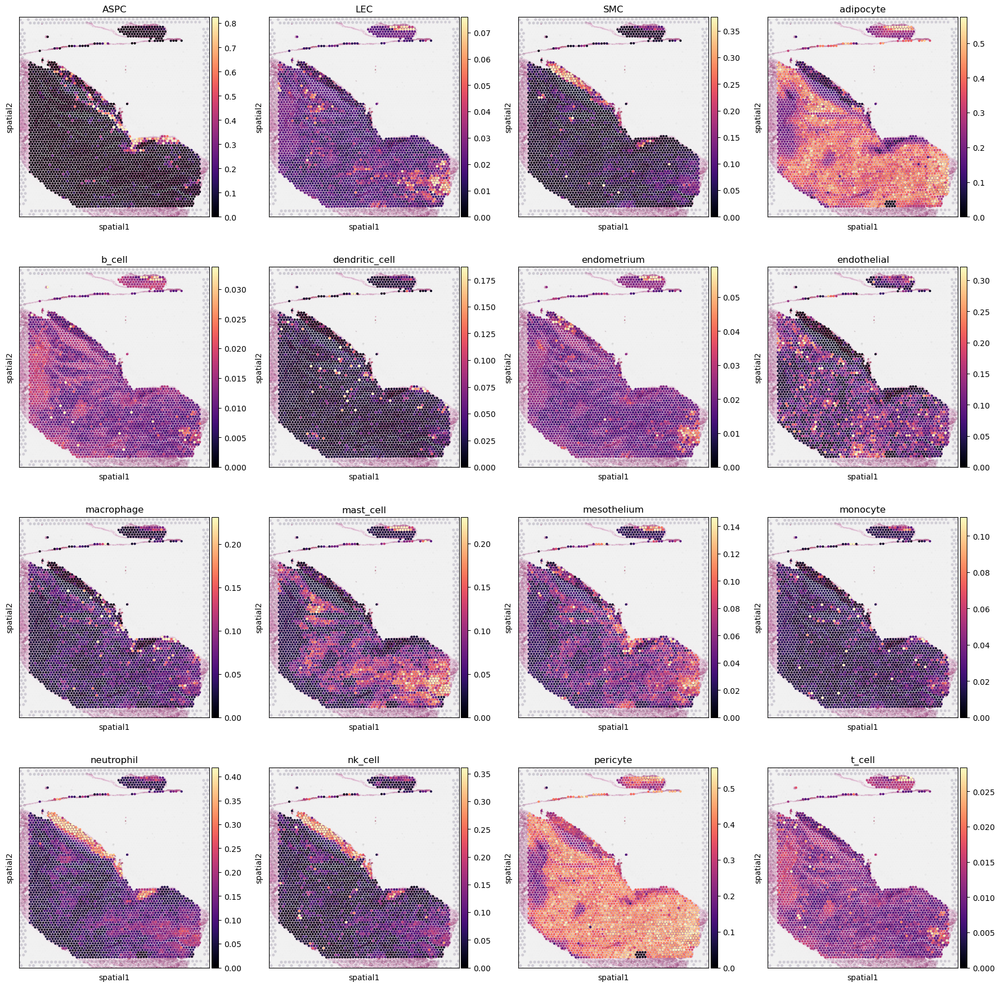

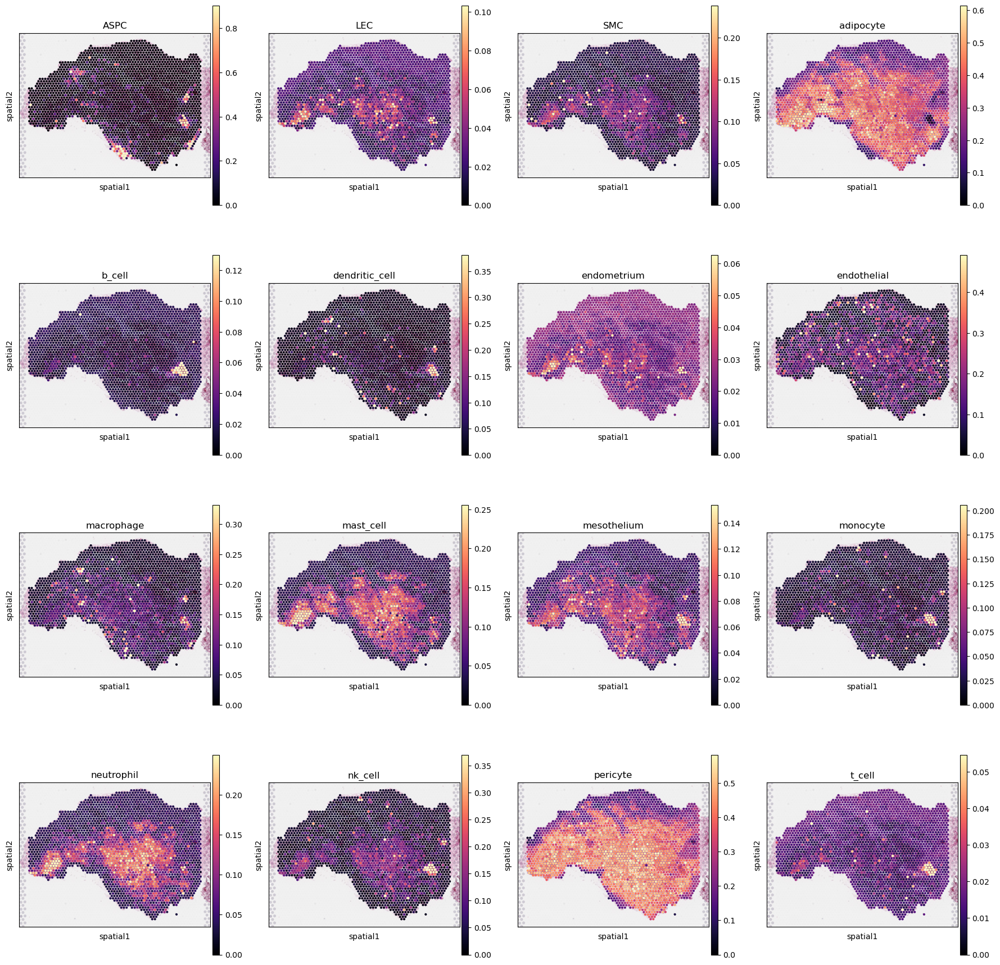

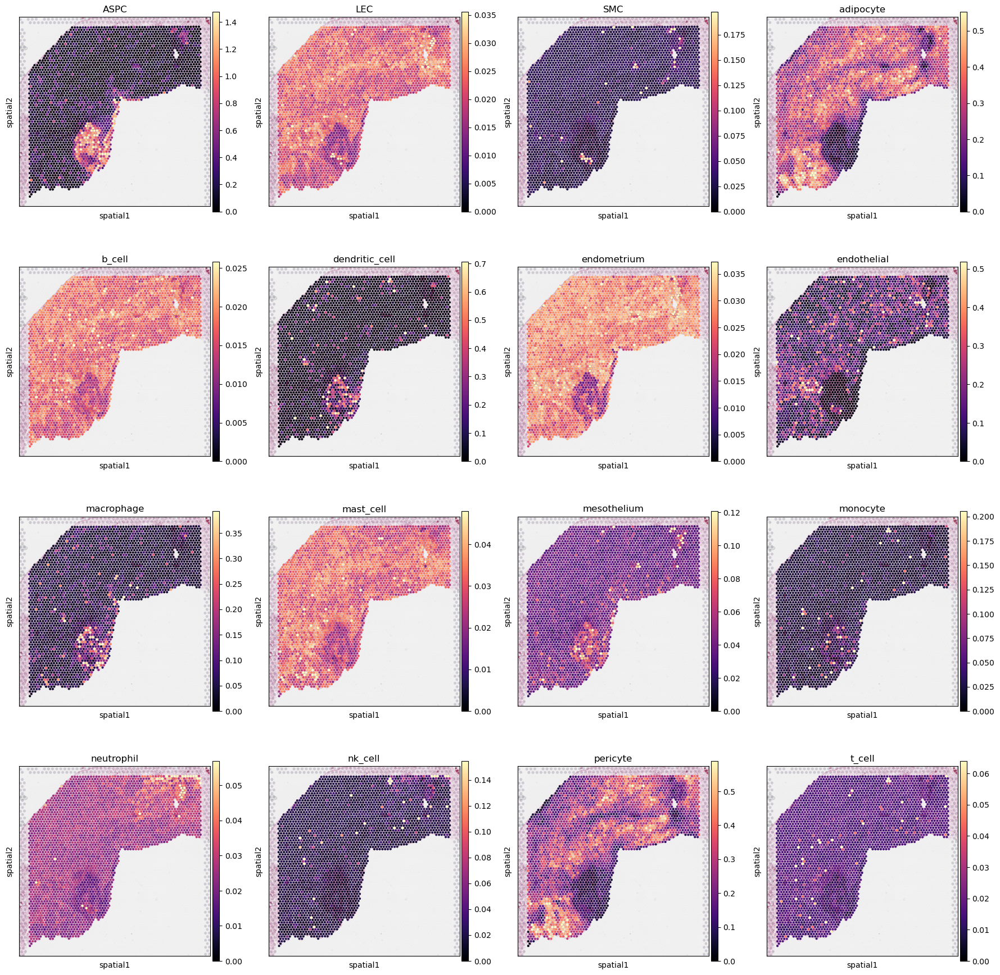

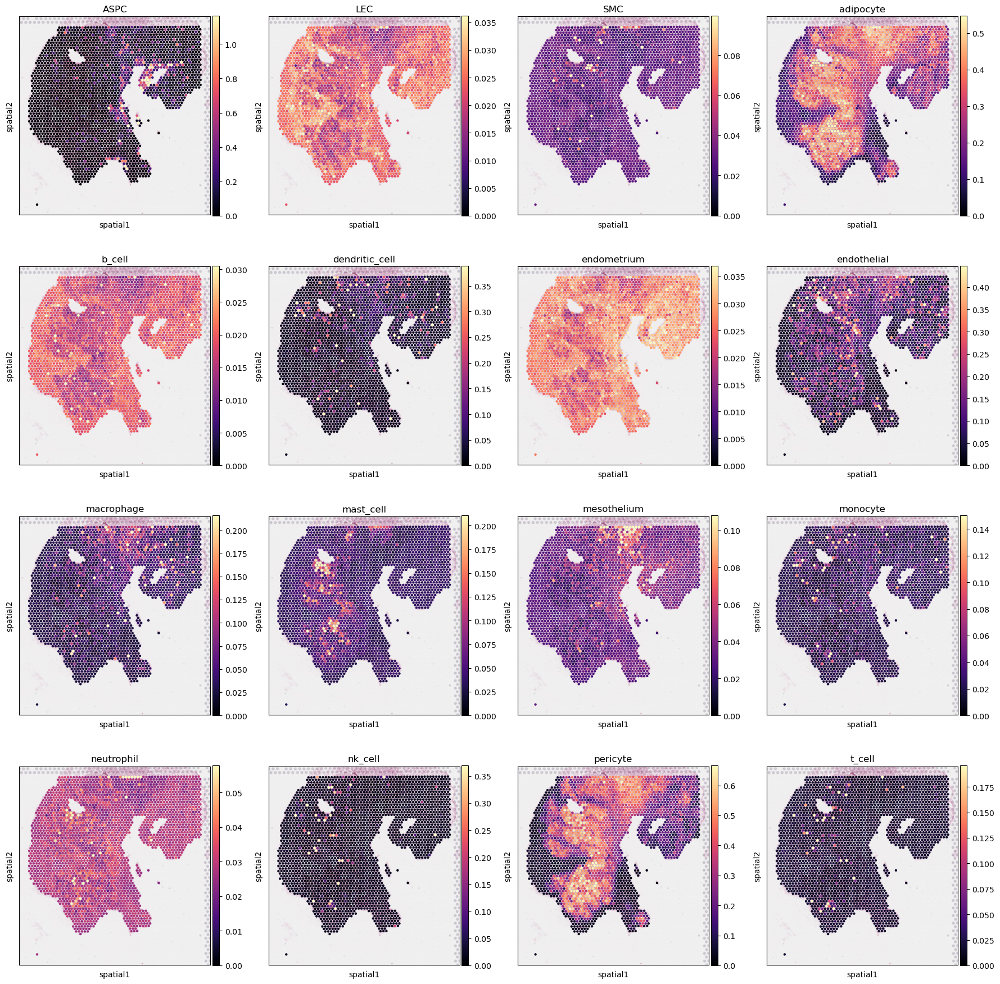

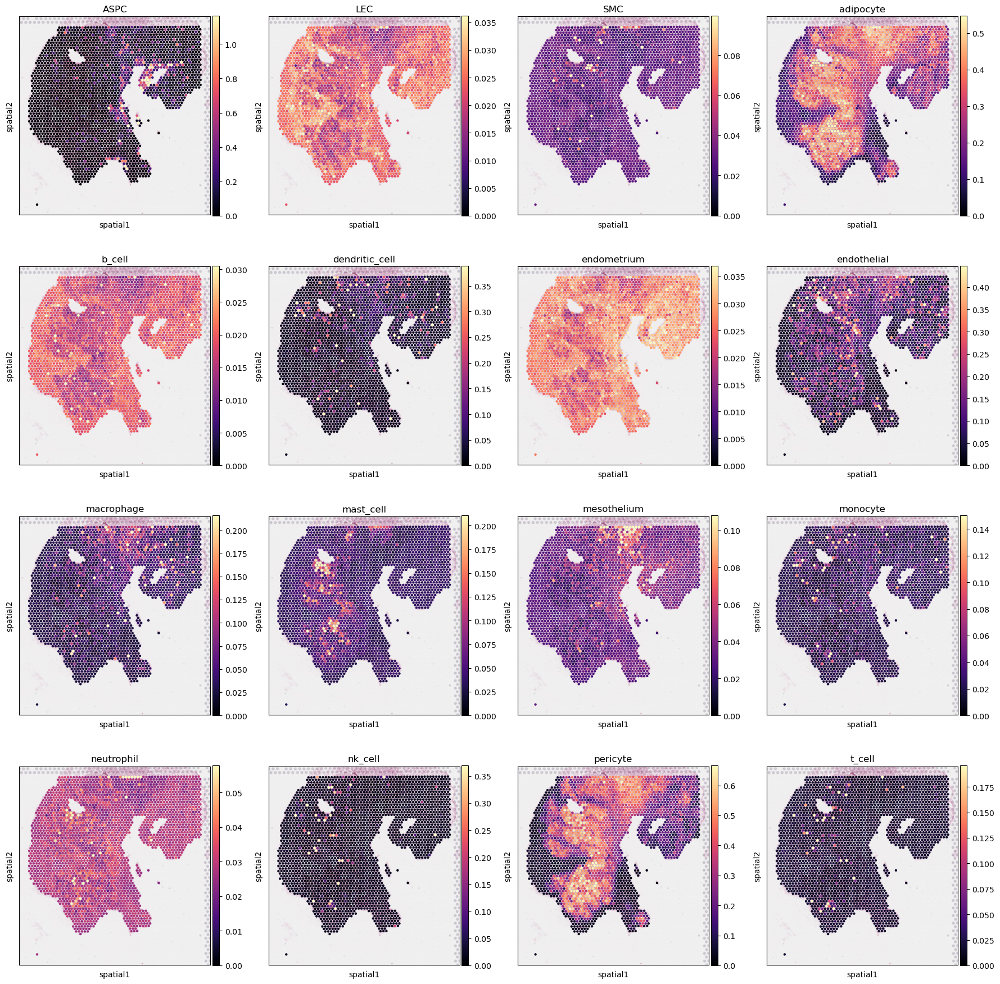

In [20]:
# add 5% quantile, representing confident cell abundance, 'at least this amount is present',
# to adata.obs with nice names for plotting
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

# select one slide
from cell2location.utils import select_slide
slide = select_slide(adata_vis, 'count-D1') ## slide name to select here

# plot in spatial coordinates
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(adata_vis.uns['mod']['factor_names']),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax='p99.2', show = True
                 )
    plt.savefig('/home/ssobti/projects/farnaz_spatial/output_data/cell2location/predicted_celltype_annot/other_outputs/N2_alpha200_D1.pdf', bbox_inches="tight")

In [8]:
# compute KNN using the cell2location output stored in adata.obsm
sc.pp.neighbors(adata_vis, use_rep='q05_cell_abundance_w_sf',
                n_neighbors = 15)

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_vis, resolution=1.1)

# add region as categorical variable
adata_vis.obs["region_cluster"] = adata_vis.obs["leiden"].astype("category")

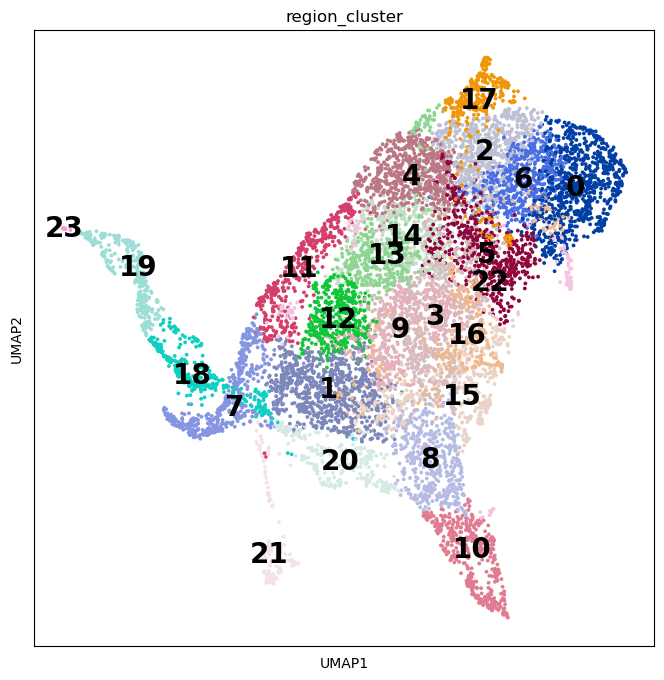

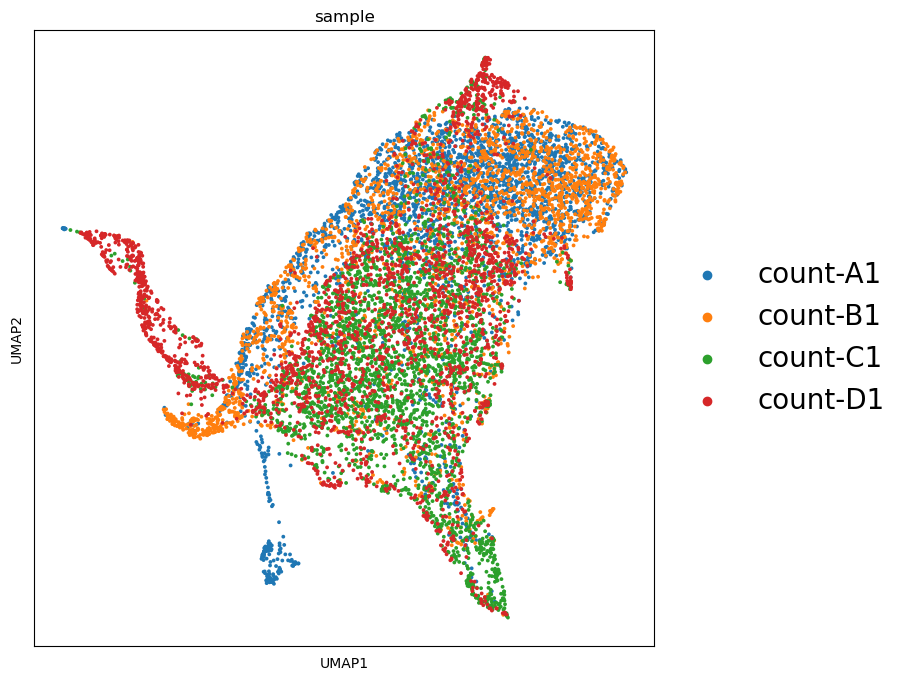

In [9]:
# compute UMAP using KNN graph based on the cell2location output
sc.tl.umap(adata_vis, min_dist = 0.3, spread = 1)

# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [8, 8]}):
    sc.pl.umap(adata_vis, color=['region_cluster'], size=30,
               color_map = 'RdPu', ncols = 2, legend_loc='on data',
               legend_fontsize=20)
    sc.pl.umap(adata_vis, color=['sample'], size=30,
               color_map = 'RdPu', ncols = 2,
               legend_fontsize=20)


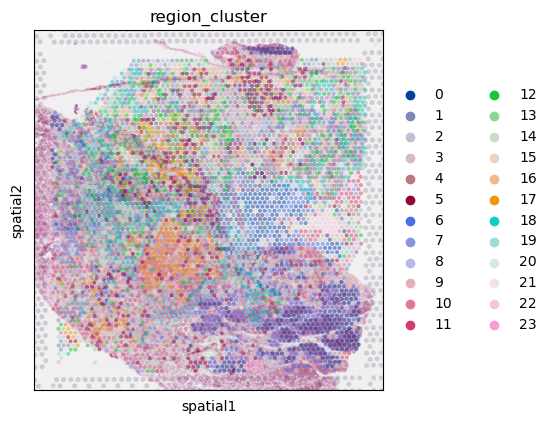

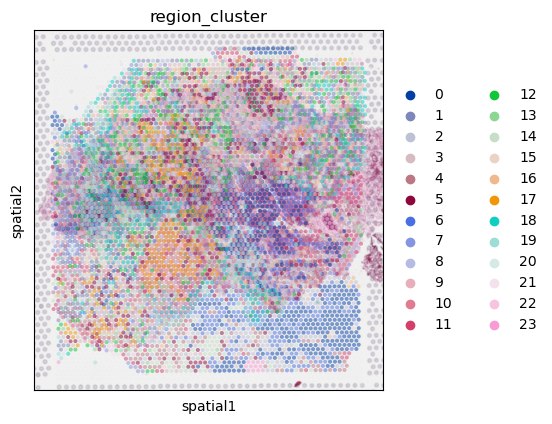

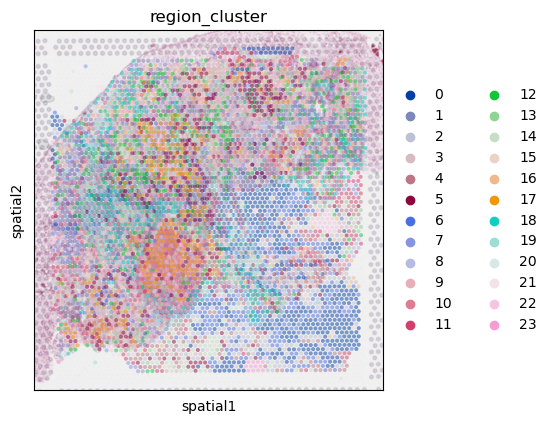

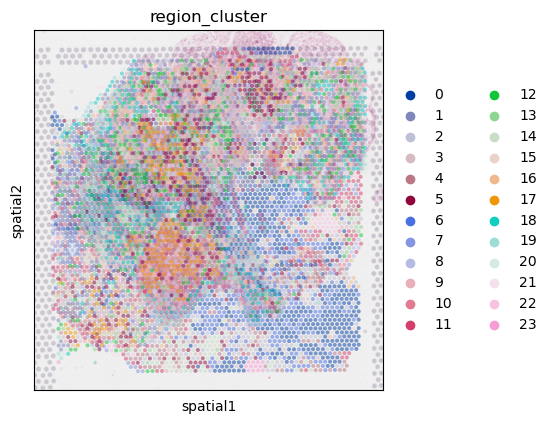

In [10]:
# plot in spatial coordinates
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):
    sc.pl.spatial(adata_vis, color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='count-A1')
    sc.pl.spatial(adata_vis, color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='count-B1')
    sc.pl.spatial(adata_vis, color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='count-C1')
    sc.pl.spatial(adata_vis, color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='count-D1')


## NMF

In [11]:
from cell2location import run_colocation
res_dict, slide = run_colocation(
    adata_vis,
    model_name='CoLocatedGroupsSklearnNMF',
    train_args={
      'n_fact': np.arange(5, 30), # IMPORTANT: use a wider range of the number of factors (5-30)
      'sample_name_col': 'sample', # columns in adata_vis.obs that identifies sample
      'n_restarts': 3 # number of training restarts
    },
    # the hyperparameters of NMF can be also adjusted:
    model_kwargs={'alpha': 0.01, 'init': 'random', "nmf_kwd_args": {"tol": 0.000001}},
    export_args={'path': f'{run_name}/CoLocatedComb/'}
)


### Analysis name: CoLocatedGroupsSklearnNMF_5combinations_10486locations_16factors


ValueError: The condensed distance matrix must contain only finite values.

In [27]:
# Compute expected expression per cell type
expected_dict = mod.module.model.compute_expected_per_cell_type(
    mod.samples["post_sample_q05"], mod.adata_manager
)

AttributeError: 'Cell2location' object has no attribute 'samples'

In [18]:
mod.print_gene_loadings(
            loadings_attr="cell_type_fractions",
            gene_fact_name="cell_type_fractions",
            top_n=min(export_args["top_n"], len(var_names)),
        )


NameError: name 'mod' is not defined

In [ ]:
mod.print_gene_loadings(gene_fact_name="gene_factors", loadings_attr="gene_loadings", top_n=10, gene_filt=None, fact_filt=None)

In [15]:
del mod

In [58]:
slide.gene_loadings

AttributeError: 'AnnData' object has no attribute 'gene_loadings'

In [115]:
for key in slide.obsm['q05_cell_abundance_w_sf'].keys():
    print(len(slide.obsm['q05_cell_abundance_w_sf'][key]))

2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733


In [55]:
for key in slide.obsm['q05_cell_abundance_w_sf'].keys():
    print(len(np.where(np.isfinite(slide.obsm['q05_cell_abundance_w_sf'][key]))[0]))


2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733
2733


In [35]:
slide.obsm['q05_cell_abundance_w_sf'].shape

(2733, 16)

In [113]:
for x in slide.obsm['q05_cell_abundance_w_sf']['q05cell_abundance_w_sf_ASPC']:
    print(x)


0.30738964676856995
0.00722815147601068
0.02148762345314026
0.02193636205047369
0.007811892731115222
0.025185628421604635
0.15726989954710008
0.00610615632031113
0.015974231529980898
0.011918534385040402
0.00985415568575263
0.010011009266600012
0.045146756991744044
0.006436661840416491
0.023785592056810856
0.010414586355909704
0.13098113387823104
0.008478251053020358
0.006372372363694012
0.018700926657766105
0.05220769289880991
0.0311010398901999
0.00953899985179305
0.007513625849969685
0.006407392141409218
0.17019299045205116
0.018771461956202985
0.015064776223152877
0.050801531225442884
0.015569324325770139
0.78510881960392
0.010694215632975101
0.009858583146706224
0.01010147393681109
0.012026856560260058
0.06740889251232147
0.009145605424419046
0.4609802633523941
0.04428563769906759
0.043825313262641434
0.02465785751119256
0.027091300673782827
0.018684824276715518
0.01602042717859149
0.056767648085951805
0.006141552841290832
0.0350544111803174
0.043587098643183705
0.0086428398732095

In [97]:
mod = Model(
    10,
    slide.obsm['q05_cell_abundance_w_sf'],
    n_iter=20000,
    verbose=verbose,
    var_names=list(slide.uns["mod"]['factor_names']) + ["neigh_" + i for i in slide.uns["mod"]['factor_names']],
    obs_names=slide.obs_names,
    fact_names=["fact_" + str(i) for i in range(30)],
    sample_id=slide.obs['sample'],
    **model_kwargs,
)

NameError: name 'Model' is not defined

In [96]:

d_model_kwargs = {"init": "random", "random_state": 0, "nmf_kwd_args": {"tol": 0.000001}, "alpha": 0.01}

NameError: name 'train_args' is not defined

In [ ]:
# create model class
n_fact = int(n_fact)
mod = Model(
    n_fact,
    X_data,
    n_iter=train_args["n_iter"],
    verbose=verbose,
    var_names=var_names,
    obs_names=obs_names,
    fact_names=["fact_" + str(i) for i in range(n_fact)],
    sample_id=sample_id,
    **model_kwargs,
)

####### Print run name #######
run_name = (
    str(mod.__class__.__name__)
    + "_"
    + str(mod.n_fact)
    + "combinations_"
    + str(mod.n_obs)
    + "locations_"
    + str(mod.n_var)
    + "factors"
    + export_args["run_name_suffix"]
)
path_name = (
    str(mod.__class__.__name__)
    + "_"
    + str(mod.n_obs)
    + "locations_"
    + str(mod.n_var)
    + "factors"
    + export_args["run_name_suffix"]
)


In [46]:
tt[0].sum()

59732448

In [23]:
np.where([True, False,ddTrue])

(array([0, 2]),)